# Introduction to Financial Technology

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy import stats
import csv
import random
import os
from BSE import market_session

## Question 1: 

You want to address the claim, “ZIP traders generate more profit than ZIC traders in homogeneous and periodic BSE markets with static and symmetric demand and supply curves”. Using BSE, configure and run a series of experiments and perform a suitable statistical hypothesis test to address this claim. Provide a brief description and motivation of your choices. Present one figure to best summarise your experimental results and interpret and explain your findings.

$h_0: X_{ZIP} = X_{ZIC}$

In [2]:
def n_runs_plot_trades(n, trial_id, start_time, end_time, traders_spec, order_sched):
    x = np.empty(0)
    y = np.empty(0)
    z = np.empty(0)
    for i in range(n):
        cato = i+1
        trialId = trial_id + '_' + str(i)
        #tdump = open(trialId + '_avg_balance.csv','w')
        tdump = {'dump_blotters': False, 'dump_lobs': False, 'dump_strats': False,
              'dump_avgbals': True, 'dump_tape': True}
        market_session(trialId, start_time, end_time, traders_spec, order_sched, tdump, True)
        
        #tdump.close()
        with open(trialId + '_tape.csv', newline='') as csvfile:
            reader = csv.reader(csvfile)
            for row in reader:
                time = float(row[1])
                price = float(row[2])
                x = np.append(x,time)
                y = np.append(y,price)
                z = np.append(z,cato)
    plt.figure()
    plt.plot(x, y, 'o', color='black')
    plt.xlabel('Time(s)')
    plt.ylabel('Transaction Price')
    print('Over!')
    return pd.DataFrame({'Time':x,'Price':y,'Period':z})

In [3]:
def n_runs_trades(n, trial_id, start_time, end_time, traders_spec, order_sched):
    for i in range(n):
        trialId = trial_id + '_' + str(i)
        #tdump = open(trialId + '_avg_balance.csv','w')
        tdump = {'dump_blotters': False, 'dump_lobs': False, 'dump_strats': False,
              'dump_avgbals': True, 'dump_tape': True}
        market_session(trialId, start_time, end_time, traders_spec, order_sched, tdump, True)
    print('Over!')

In [4]:
trial_id = 'data/1127/ZIC'
sellers_spec = [('ZIC', 10)]
buyers_spec = sellers_spec

traders_spec = {'sellers':sellers_spec, 'buyers':buyers_spec}

range1 = (50, 100)  # equilibrium_price1 ~ 75
range2 = (150, 200) # equilibrium_price2 ~ 175

start_time = 0
end_time = 60 * 10

supply_schedule = [{'from': start_time, 'to': end_time, 'ranges': [range2], 'stepmode': 'fixed'}]
demand_schedule = supply_schedule
# create a market maker with default parameter settings and add to traders_spec
# mrktmakers_spec = [('MMM01', 1)]
# traders_spec = {'sellers': sellers_spec, 'buyers': buyers_spec, 'mrktmakers': mrktmakers_spec}
traders_spec = {'sellers': sellers_spec, 'buyers': buyers_spec}
order_interval = 15 # the time interval that order schedule takes to cycle through buyers and sellers and supply them with new orders
order_sched = {'sup': supply_schedule, 'dem': demand_schedule,
               'interval': order_interval, 'timemode': 'periodic'}
n=50

n_runs_trades(n, trial_id, start_time, end_time, traders_spec, order_sched)


data/1127/ZIC_0;  
trader=B08 order=None
trader=S06 order=None
trader=B01 order=None
trader=S04 order=None
trader=S06 order=None
trader=B06 order=None
trader=B08 order=None
trader=S00 order=None
trader=S01 order=None
trader=B02 order=None
trader=B03 order=None
trader=S08 order=None
trader=S00 order=None
trader=S04 order=None
trader=B03 order=None
trader=B09 order=None
trader=S07 order=None
trader=S04 order=None
trader=B00 order=None
trader=B07 order=None
trader=B06 order=None
trader=B07 order=None
trader=S07 order=None
trader=B05 order=None
trader=S05 order=None
trader=B03 order=None
trader=B02 order=None
trader=S07 order=None
trader=S05 order=None
trader=B00 order=None
trader=B02 order=None
trader=S02 order=None
trader=S09 order=None
trader=S07 order=None
trader=B01 order=None
trader=B09 order=None
trader=S05 order=None
trader=B02 order=None
trader=B05 order=None
trader=B01 order=None
trader=S03 order=None
trader=B06 order=None
trader=S01 order=None
trader=S05 order=None
trader=S05 o

In [8]:
path = "data/1127"
zip = []
zic = []
for filename in os.listdir(path):
    if filename.endswith(".csv") and 'ZIP' in str(filename) and 'tape' not in str(filename):
        df = pd.read_csv(os.path.join(path, filename))
        if df.shape[0] == 0:
            print("⚠️ Skipped empty file:", filename)
            continue
        #print("Loaded:", filename)
        a = df.iloc[-1,7]
        zip.append(a)
    if filename.endswith(".csv") and 'ZIC' in str(filename) and 'tape' not in str(filename):
        df = pd.read_csv(os.path.join(path, filename))
        if df.shape[0] == 0:
            print("⚠️ Skipped empty file:", filename)
            continue
        #print("Loaded:", filename)
        a = df.iloc[-1,7]
        zic.append(a)
data1 = [zip,zic]
print('The length of ZIP trade record is',{len(zip)})
print('The length of ZIC trade record is',{len(zic)})
#data1.to_csv('1127result.csv')

⚠️ Skipped empty file: ZIP_30_avg_balance.csv
⚠️ Skipped empty file: ZIP_32_avg_balance.csv
⚠️ Skipped empty file: ZIP_36_avg_balance.csv
The length of ZIP trade record is {47}
The length of ZIC trade record is {50}


C:\Users\86158\AppData\Local\Temp\ipykernel_10836\762841256.py:4: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  p1.show()


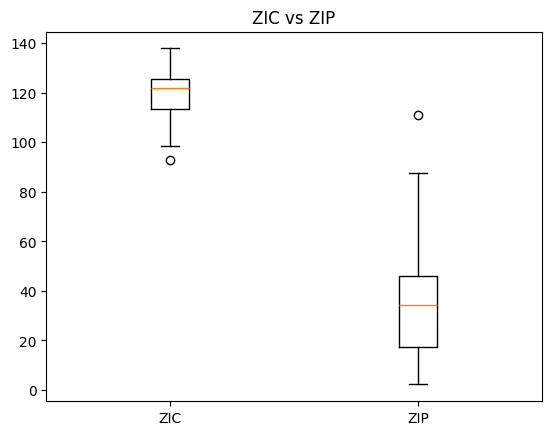

In [9]:
p1 = plt.figure()
plt.boxplot([zic,zip],labels=['ZIC','ZIP'])
plt.title('ZIC vs ZIP')
p1.show()

The t-value indicates the mean of ZIP trader's profit is lower than the mean of ZIC trader's profit.

In [11]:
t, p = stats.ttest_ind(zip, zic)
print("t =", t)
print("p =", p)

t = -24.62233526879518
p = 5.075514159192731e-43


## Question 2:

In Vernon Smith’s seminal 1962 paper, he performed a series of trading experiments. Each experiment, human participants are divided into buyers and sellers. Buyers and sellers are allocated a card with a reservation price (maximum price to buy; or minimum price to sell) and then asked to trade. When no more trades take place, a new “period” begins. At the start of the new period, buyers and sellers are re-allocated a new reservation card and asked to trade again. The experiment repeats for P periods. Results from one of Smith’s experiments (“Chart 5”) is copied below.

Using BSE, reproduce Smith’s Chart 5 experimental framework as closely as you can, but replace human participants with heterogeneous markets containing approximately equal numbers of ZIP, SHVR, and ZIC trading agents. Describe your experimental configuration. Then show two plots of demand and supply, before and after market shock, with equilibrium price indicated by horizontal dotted line. Finally, plot your trading results in the same style as Smith, with “transaction prices” on the y-axis and “transaction number (per period)” on the x-axis and dotted lines indicating theoretical equilibrium price and the start/end of each period. Describe how your results compare with Smith’s results. You can re-run your market as many times as you like, but you should only show results from one representative run.


data/1127/Q2_0;  
trader=S17 order=None
trader=B08 order=None
trader=S16 order=None
trader=B16 order=None
trader=S16 order=None
trader=S13 order=None
trader=B17 order=None
trader=B10 order=None
trader=B03 order=None
trader=S03 order=None
trader=B29 order=None
trader=S04 order=None
trader=B00 order=None
trader=B10 order=None
trader=B24 order=None
trader=B01 order=None
trader=B16 order=None
trader=B22 order=None
trader=S03 order=None
trader=S08 order=None
trader=S11 order=None
trader=B05 order=None
trader=S25 order=None
trader=S26 order=None
trader=S28 order=None
trader=B29 order=None
trader=S23 order=None
trader=S13 order=None
trader=B06 order=None
trader=S11 order=None
trader=B20 order=None
trader=S23 order=None
trader=B07 order=None
trader=S22 order=None
trader=B00 order=None
trader=S01 order=None
trader=B18 order=None
trader=B26 order=None
trader=S25 order=None
trader=S18 order=None
trader=B21 order=None
trader=B27 order=None
trader=S16 order=None
trader=S04 order=None
trader=S13 or

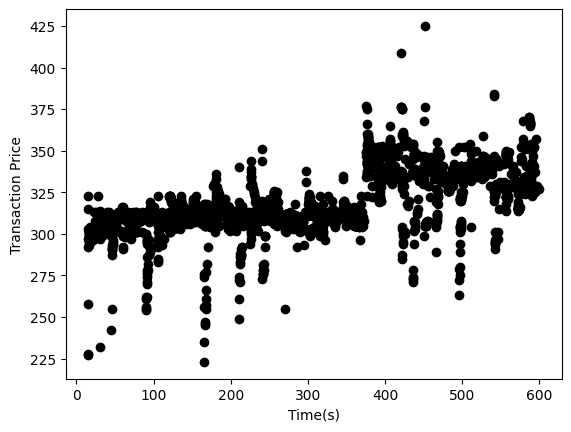

In [4]:
trial_id = 'data/1127/Q2'
sellers_spec = [('ZIC', 10),('ZIP',10),('SHVR',10)]
buyers_spec = sellers_spec

traders_spec = {'sellers':sellers_spec, 'buyers':buyers_spec}

demand_range1 = (280,375)
demand_range2 = (300,470)
supply_range1 = (210, 360)  # equilibrium_price1 ~ 75
supply_range2 = (220, 380) # equilibrium_price2 ~ 175

start_time = 0
mid_time = 60 * 6
end_time = 60 * 10

supply_schedule = [{'from': start_time, 'to': mid_time, 'ranges': [supply_range1], 'stepmode': 'fixed'},
                   {'from': mid_time, 'to': end_time, 'ranges': [supply_range2], 'stepmode': 'fixed'}]
demand_schedule = [{'from': start_time, 'to': mid_time, 'ranges': [demand_range1], 'stepmode': 'fixed'},
                   {'from': mid_time, 'to': end_time, 'ranges': [demand_range2], 'stepmode': 'fixed'}]
# create a market maker with default parameter settings and add to traders_spec
# mrktmakers_spec = [('MMM01', 1)]
# traders_spec = {'sellers': sellers_spec, 'buyers': buyers_spec, 'mrktmakers': mrktmakers_spec}
traders_spec = {'sellers': sellers_spec, 'buyers': buyers_spec}
order_interval = 15 # the time interval that order schedule takes to cycle through buyers and sellers and supply them with new orders
order_sched = {'sup': supply_schedule, 'dem': demand_schedule,
               'interval': order_interval, 'timemode': 'periodic'}
n=3

df2 = n_runs_plot_trades(n, trial_id, start_time, end_time, traders_spec, order_sched)

In [91]:
def getorderprice(i, sched, n, mode):
    pmin = min(sched[0][0], sched[0][1])
    pmax = max(sched[0][0], sched[0][1])
    prange = pmax - pmin
    stepsize = prange / (n - 1)
    halfstep = round(stepsize / 2.0)

    if mode == 'fixed':
        orderprice = pmin + int(i * stepsize)
    elif mode == 'jittered':
        orderprice = pmin + int(i * stepsize) + random.randint(-halfstep, halfstep)
    elif mode == 'random':
        if len(sched) > 1:
            # more than one schedule: choose one equiprobably
            s = random.randint(0, len(sched) - 1)
            pmin = min(sched[s][0], sched[s][1])
            pmax = max(sched[s][0], sched[s][1])
        orderprice = random.randint(pmin, pmax)
    return orderprice    

def make_supply_demand_plot(bids, asks,equalibrium):
    # total volume up to current order
    volS = 0
    volB = 0

    fig, ax = plt.subplots()
    plt.ylabel('Price')
    plt.xlabel('Quantity')
    colors = ['r','b']
    pr = 0

    demand_label = ['D_1',"D_2"]
    supply_label = ['S_1',"S_2'"]
    for bid in bids:
        i=0
        for b in bid:            
            if pr != 0 and b!=bid[-1]:
                # vertical line
                ax.plot([volB,volB], [pr,b], 'r-')
            elif pr!=0 and b==bid[-1]:
                ax.plot([volB,volB], [pr,b], 'r-',label = demand_label[i])
        # horizontal lines
            line, = ax.plot([volB,volB+1], [b,b], 'r-')
            volB += 1
            pr = b
        pr=0
        volS = 0
        volB = 0
        i+=1

        
    pr = 0
    for ask in asks:
        i=0
        for s in ask:
            if pr != 0 and s!=ask[-1]:
                # vertical line
                ax.plot([volS,volS], [pr,s], 'b-')
            elif pr!=0 and s==ask[-1]:
                ax.plot([volS,volS], [pr,s], 'b-',label = supply_label[i])
            # horizontal lines
            line, = ax.plot([volS,volS+1], [s,s], 'b-')
            volS += 1
            pr = s
            
        pr=0
        volS = 0
        volB = 0
        i+=1
    a = max(ax.get_xlim())
    if bids or asks:
        plt.legend()
    for p in equalibrium:
        ax.plot([0,a],[p,p],linestyle = '--',color='gray',linewidth = 1)
    plt.show()


def plot_sup_dem(seller_num, buyer_num, stepmode,equilibrium, dem_ranges=[], sup_ranges = []):
    asks = [] # ask = [[],[]]
    if len(dem_ranges)>1:
        for sup_range in sup_ranges:
            ask_list = []
            for s in range(seller_num):
                ask_list.append(getorderprice(s, sup_range, seller_num, stepmode))
            ask_list.sort()
            asks.append(ask_list)
        
        bids = []
        for dem_range in dem_ranges:
            bid_list = []
            for b in range(buyer_num):
                bid_list.append(getorderprice(b, dem_range, buyer_num, stepmode))
            bid_list.sort()
            bid_list.reverse()
            bids.append(bid_list)
        
    make_supply_demand_plot(bids, asks,equilibrium) 

In [81]:
def equilibrium_price(supply_range,demand_range):
    sup_spread = max(supply_range) - min(supply_range)
    dem_spread = max(demand_range) - min(demand_range)
    return (sup_spread * max(demand_range) + dem_spread * min(supply_range))/(sup_spread+dem_spread)
equilibrium_price1 = equilibrium_price(supply_range1,demand_range1)
equilibrium_price2 = equilibrium_price(supply_range2,demand_range2)
eq_p = [equilibrium_price1,equilibrium_price2]

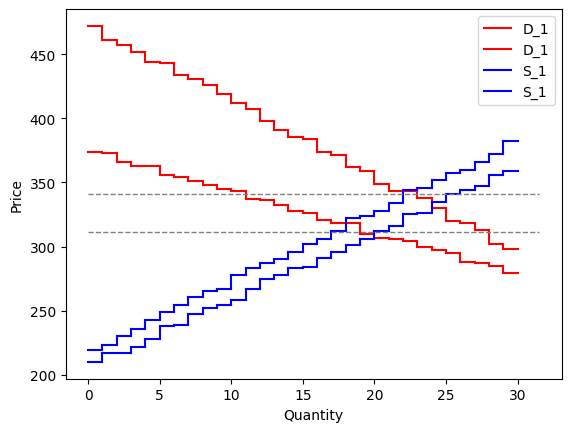

In [92]:
plot_sup_dem(30,30,'jittered',eq_p,[[demand_range1],[demand_range2]],[[supply_range1],[supply_range2]])


data/Q2/before_0;  
trader=B14 order=None
trader=S22 order=None
trader=S06 order=None
trader=S28 order=None
trader=B15 order=None
trader=B16 order=None
trader=B22 order=None
trader=S16 order=None
trader=S01 order=None
trader=S10 order=None
trader=S19 order=None
trader=S23 order=None
trader=S00 order=None
trader=S15 order=None
trader=S01 order=None
trader=S27 order=None
trader=B17 order=None
trader=S26 order=None
trader=B17 order=None
trader=S27 order=None
trader=B18 order=None
trader=B00 order=None
trader=B28 order=None
trader=B19 order=None
trader=S27 order=None
trader=B10 order=None
trader=S28 order=None
trader=B26 order=None
trader=B14 order=None
trader=B20 order=None
trader=B20 order=None
trader=S06 order=None
trader=B25 order=None
trader=B01 order=None
trader=S05 order=None
trader=S21 order=None
trader=S18 order=None
trader=S15 order=None
trader=S22 order=None
trader=S08 order=None
trader=S06 order=None
trader=S07 order=None
trader=S10 order=None
trader=B12 order=None
trader=S22 

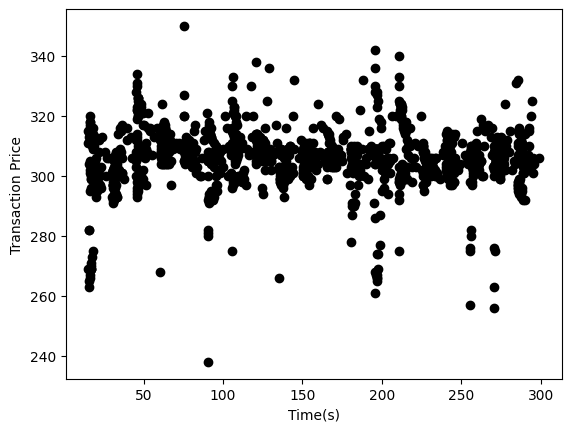

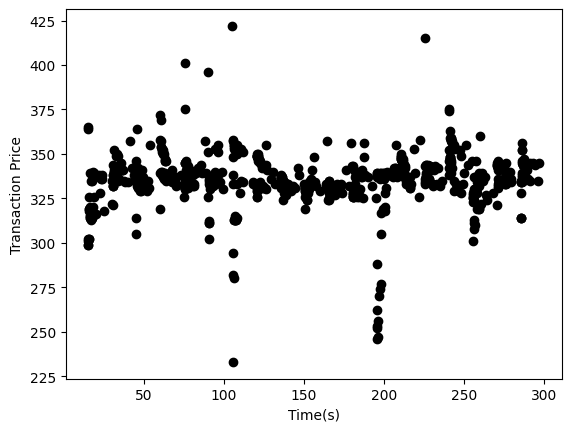

In [49]:
trial_id = 'data/Q2/before'
n = 4
start_time = 0
end_time = 60 * 5
supply_schedule1 = [{'from': start_time, 'to':end_time, 'ranges': [supply_range1], 'stepmode': 'jittered'}]
demand_schedule1 = [{'from': start_time, 'to': end_time, 'ranges': [demand_range1], 'stepmode': 'jittered'}]
traders_spec = {'sellers': sellers_spec, 'buyers': buyers_spec}
order_interval = 15 
order_sched = {'sup': supply_schedule1, 'dem': demand_schedule1,
               'interval': order_interval, 'timemode': 'periodic'}
df3 = n_runs_plot_trades(n, trial_id, start_time, end_time, traders_spec, order_sched)

n=2
trial_id = 'data/Q2/after'
supply_schedule2 = [{'from': start_time, 'to':end_time, 'ranges': [supply_range2], 'stepmode': 'jittered'}]
demand_schedule2 = [{'from': start_time, 'to': end_time, 'ranges': [demand_range2], 'stepmode': 'jittered'}]
traders_spec = {'sellers': sellers_spec, 'buyers': buyers_spec}
order_sched = {'sup': supply_schedule2, 'dem': demand_schedule2,
               'interval': order_interval, 'timemode': 'periodic'}
df4 = n_runs_plot_trades(n, trial_id, start_time, end_time, traders_spec, order_sched)

Loaded: before_0_tape.csv
Loaded: before_1_tape.csv
Loaded: before_2_tape.csv
Loaded: before_3_tape.csv
Loaded: after_0_tape.csv
Loaded: after_1_tape.csv


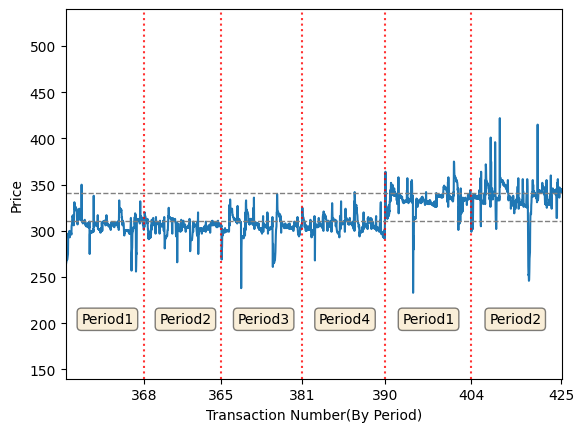

In [121]:
path = "data/Q2"
D1 = []
for filename in os.listdir(path):
    if filename.endswith(".csv") and 'before' in str(filename) and 'tape' in str(filename):
        df = pd.read_csv(os.path.join(path, filename))
        if df.shape[0] != 0:
            print("Loaded:", filename) 
        a = df.iloc[:,-1]
        D1.append(a)
for filename in os.listdir(path):
    if filename.endswith(".csv") and 'after' in str(filename) and 'tape' in str(filename):
        df = pd.read_csv(os.path.join(path, filename))
        if df.shape[0] != 0:
            print("Loaded:", filename) 
        a = df.iloc[:,-1]
        D1.append(a)

dic = {'Period1':D1[0],'Period2':D1[1],'Period3':D1[2],'Period4':D1[3],'Period5':D1[4],
       'Period6':D1[5]}
len1, len2, len3, len4, len5, len6 = len(D1[0]), len(D1[1]), len(D1[2]),len(D1[3]),len(D1[4]),len(D1[5])
dic = pd.DataFrame(dic)
D1 = [*D1[0],*D1[1],*D1[2],*D1[3],*D1[4],*D1[5]]
len2 = len1+len2
len3 = len2+len3
len4 = len3+len4
len5 = len4+len5
len6 = len5+len6
bbox_set = {'boxstyle':'round','facecolor':'wheat','alpha':0.5}
pos = 200
fig, ax = plt.subplots()
ax.set_ylim(140,540)
ax.set_xlim(0,len(D1)+1)
ax.plot(range(1,len(D1)+1), D1, linestyle='-')
ax.plot([len1,len1], [140, 540], ':', color='red', alpha=0.8)
ax.plot([len2,len2], [140, 540], ':', color='red', alpha=0.8)
ax.plot([len3,len3], [140, 540], ':', color='red', alpha=0.8)
ax.plot([len4,len4], [140, 540], ':', color='red', alpha=0.8)
ax.plot([len5,len5], [140, 540], ':', color='red', alpha=0.8)
ax.plot([0,len(D1)],[equilibrium_price1,equilibrium_price1],linestyle = '--',color='gray',linewidth =1)
ax.plot([0,len(D1)],[equilibrium_price2,equilibrium_price2],linestyle = '--',color='gray',linewidth =1)
ax.text(1/5*len1,pos,'Period1',bbox=bbox_set)
ax.text(len1+1/5*(len2-len1),pos,'Period2',bbox=bbox_set)
ax.text(len2+1/5*(len3-len2),pos,'Period3',bbox=bbox_set)
ax.text(len3+1/5*(len4-len3),pos,'Period4',bbox=bbox_set)
ax.text(len4+1/5*(len5-len4),pos,'Period1',bbox=bbox_set)
ax.text(len5+1/5*(len6-len5),pos,'Period2',bbox=bbox_set)
ax.set_xticks([len1, len2, len3, len4, len5,len6])
ax.set_xticklabels([len1,len2-len1,len3-len2,len4-len3,len5-len4,len6-len5])
ax.set_xlabel('Transaction Number(By Period)')
ax.set_ylabel('Price')
plt.show()

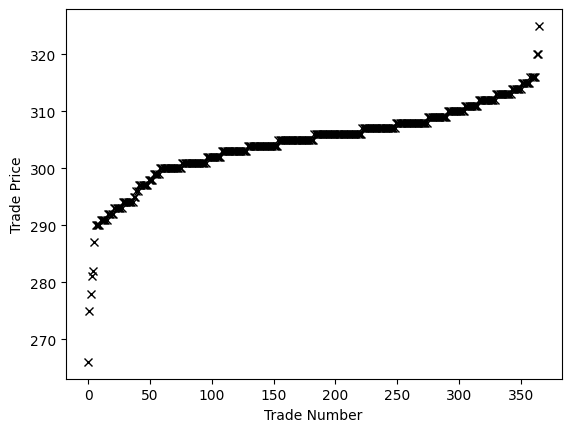

In [125]:
def in_order_plot(trial_id):
    prices_fname = trial_id + '_tape.csv'
    y = np.empty(0)
    with open(prices_fname, newline='') as csvfile:
        reader = csv.reader(csvfile)
        for row in reader:
            price = float(row[2])
            y = np.append(y,price)
    y = np.sort(y)
    x = list(range(len(y)))
    plt.xlabel('Trade Number')
    plt.ylabel('Trade Price')
    plt.plot(x, y, 'x', color='black') 

in_order_plot('data/Q2/before_1')

## Question 3: 
BSE includes a Minimal Market Maker MMM01, which has three configuration parameters with default settings: $n\_past\_trades=1$, $bid\_percent=0.5$, $ask\_delta=25$.

Your task is to systematically explore MMM01 parameter values to determine a set of robust values that maximise profits. To do this, you should test different vectors of parameter values by configuring a series of BSE experiments **with various market conditions**, performenough IID runs to get useful data, and then perform **data analytics, visualisation, and hypothesis testing** to draw valid conclusions.Finally, clearly state the three parameter values that you select as your best performing configuration –we will call this best configuration MMM01*. 

To achieve a high mark, you should carefully consider the market configurations that you will use to test MMM01 profitability: your configurations should include at least one market that **incorporates real pricing data as input** to offset supply and demand; and at least one market that does not incorporate real pricing data as input.  You should also carefully select the length of simulations that you will run and the number of repeated IID trials, N.  Finally, consider which other trader types you will include in the market. You should clearly **state your configurations** and provide a brief justification of **why you have chosen these configurations**. When presenting results, you should minimise the number of figures you present –i.e., only include figures that are necessary.